In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import math
import seaborn as sns
import json
import powerlaw
import geopandas as gdp
import scipy

In [2]:
%matplotlib inline

In [3]:
!ls geo_data

OA_2021_EW_BFC_V7.cpg
OA_2021_EW_BFC_V7.dbf
OA_2021_EW_BFC_V7.prj
OA_2021_EW_BFC_V7.shp
OA_2021_EW_BFC_V7.shx
Output_Areas_Dec_2021_Boundaries_Full_Clipped_EW_BFC_2022_-340120420164038365.csv
Output_Areas_Dec_2021_Boundaries_Full_Clipped_EW_BFC_2022_5714326745691218172.zip
PARNCP_DEC_2021_EW_BSC.cpg
PARNCP_DEC_2021_EW_BSC.dbf
PARNCP_DEC_2021_EW_BSC.prj
PARNCP_DEC_2021_EW_BSC.shp
PARNCP_DEC_2021_EW_BSC.shx
Parishes_and_Non_Civil_Parished_Areas_(December_2021)_EW_BSC.xml
Parishes_and_Non_Civil_Parished_Areas_(December_2021)_EW_BSC.zip


In [4]:
geo_df = gdp.read_file('geo_data/PARNCP_DEC_2021_EW_BSC.shp')
geo_df.head()

,OBJECTID,PARNCP21CD,PARNCP21NM,PARNCP21NW,BNG_E,BNG_N,LONG,LAT,SHAPE_Leng,SHAPE_Area,geometry
0,1,E04000001,Blackrod,NaN,361020,410662,-2.59036,53.591091,14444.180308,8.373290e+06,"POLYGON ((362368.997 411138.402, 363545.196 40..."
1,2,E04000002,Horwich,NaN,365741,411963,-2.51919,53.603111,20207.437672,1.454181e+07,"POLYGON ((366340.404 414544.797, 365894.099 41..."
2,3,E04000003,Westhoughton,NaN,365008,406179,-2.52961,53.551079,19733.095935,1.803568e+07,"POLYGON ((366943.596 404722.699, 366504.101 40..."
3,4,E04000004,Ringway,NaN,381192,384606,-2.28405,53.358009,12248.078787,6.587533e+06,"POLYGON ((382864.100 384761.003, 382318.697 38..."
4,5,E04000005,Saddleworth,NaN,400672,407034,-1.99132,53.559940,41614.516542,7.587037e+07,"POLYGON ((399470.898 413357.697, 401312.300 41..."


<Axes: >

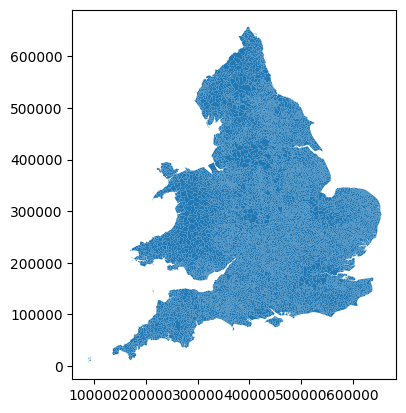

In [5]:
geo_df.plot()

In [9]:
geo_df.to_crs(epsg=3857, inplace=True)

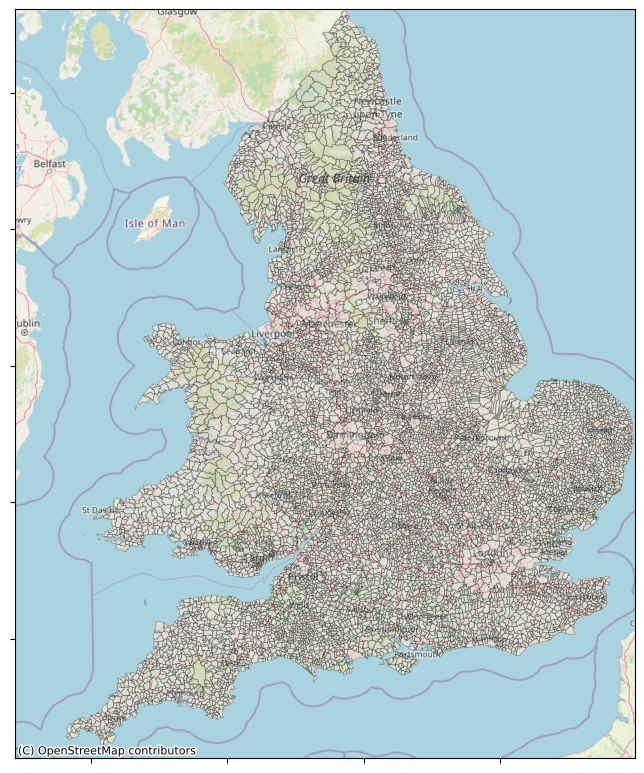

In [13]:
from shapely.ops import cascaded_union

fig, ax = plt.subplots(figsize=(8,12))
# Define Overall Polygon
#overall_polygon = gdp.GeoSeries(cascaded_union(geo_df.geometry))
# Define bounding box
#bounds = overall_polygon.bounds
bounding_box = [
    bounds['minx'][0],
    bounds['maxx'][0],
    bounds['miny'][0],
    bounds['maxy'][0],
]
# Set bounds
ax.set_xlim(bounding_box[0]-1000, bounding_box[1] + 1000)
ax.set_ylim(bounding_box[2]-1000, bounding_box[3] + 1000)

# Plot borough borders
geo_df.plot(
    ax=ax, 
    alpha=0.3, 
    edgecolor='black', 
    linewidth=0.5,
    facecolor='silver',
)

import contextily as cx # map backgrounds
# Add background
cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik)

# Remove axis 
ax.set_yticklabels([])
ax.set_xticklabels([])

plt.show()

### Getting wholly rural parishes

In [14]:
oa_to_parish_lookup = pd.read_csv('data/OAs_(2021)_to_Civil_Parish_and_Non-Civil_Parished_Areas_to_LTLA_to_UTLA_to_Region_to_Country_(May_2022)_Lookup_in_England_and_Wales.csv')
oa_to_parish_lookup = oa_to_parish_lookup[[
    'OA21CD',
    'PAR22CD',
    'PAR22NM',
    'RGN22NM'
]]
oa_populations = pd.read_csv('data/census2021-ts001-oa.csv')
oa_total_frame = oa_to_parish_lookup.merge(
    oa_populations[['geography code', 'Residence type: Total; measures: Value']], 
    how='inner', 
    left_on='OA21CD', 
    right_on='geography code')
oa_total_frame = oa_total_frame.rename(columns={'Residence type: Total; measures: Value': 'population'}, errors='raise')
oa_total_frame = oa_total_frame[[
    'OA21CD',
    'PAR22CD',
    'PAR22NM',
    'RGN22NM',
    'population'
]]
size_frame = pd.read_csv('geo_data/Output_Areas_Dec_2021_Boundaries_Full_Clipped_EW_BFC_2022_-340120420164038365.csv')
oa_total_frame = oa_total_frame.merge(
    size_frame[['OA21CD', 'Shape__Area']],
    how='inner',
    on='OA21CD'
)
oa_total_frame = oa_total_frame.rename(
    columns={'Shape__Area': 'area'}, 
    errors='raise'
)
drop_wales = oa_total_frame[oa_total_frame.RGN22NM != 'Wales']

parish_frame = drop_wales[['PAR22CD', 'PAR22NM', 'RGN22NM', 'population', 'area']].groupby(['PAR22CD', 'PAR22NM', 'RGN22NM']).agg('sum').reset_index()
rural_urban_lookup = pd.read_csv('data/RUC11_OA11_EW.csv')
oa11_oa21_lookup = pd.read_csv('data/OA_(2011)_to_OA_(2021)_to_Local_Authority_District_(2022)_for_England_and_Wales_Lookup_(Version_2).csv')
rural_urban_lookup = rural_urban_lookup[['OA11CD', 'RUC11CD', 'RUC11']].merge(
    oa11_oa21_lookup[['OA11CD', 'OA21CD']],
    how='left',
    on='OA11CD'
)

with_rural = drop_wales.merge(
    rural_urban_lookup[[
        'OA21CD',
        'RUC11CD',
        'RUC11'
    ]],
    how='left',
    on='OA21CD'
)
official_rural_list = [
    'D1', 'E1', 'F1', 'D2', 'E2', 'F2'
]
with_rural['is_rural'] = with_rural.RUC11CD.isin(official_rural_list)


/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/849855028.py:1: DtypeWarning: Columns (4,7,10,13) have mixed types. Specify dtype option on import or set low_memory=False.
  oa_to_parish_lookup = pd.read_csv('data/OAs_(2021)_to_Civil_Parish_and_Non-Civil_Parished_Areas_to_LTLA_to_UTLA_to_Region_to_Country_(May_2022)_Lookup_in_England_and_Wales.csv')
/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/849855028.py:36: DtypeWarning: Columns (6) have mixed types. Specify dtype option on import or set low_memory=False.
  oa11_oa21_lookup = pd.read_csv('data/OA_(2011)_to_OA_(2021)_to_Local_Authority_District_(2022)_for_England_and_Wales_Lookup_(Version_2).csv')


In [16]:
classification = with_rural.groupby(['PAR22CD']).is_rural.apply(lambda x: x.sum() / x.size).reset_index()
def classify_parish(x):
    if x == 0:
        return 'Urban'
    elif x == 1:
        return 'Rural'
    else:
        return 'Mixed'
classification['rural_label'] = classification.is_rural.apply(classify_parish)

In [18]:
parish_data = parish_frame.merge(classification[['PAR22CD', 'rural_label']], how='inner', on='PAR22CD')
parish_data.head()

,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
0,E04000001,Blackrod,North West,5517,8.599134e+06,Urban
1,E04000002,Horwich,North West,20908,1.424275e+07,Mixed
2,E04000003,Westhoughton,North West,25340,1.786415e+07,Mixed
3,E04000005,Saddleworth,North West,25466,7.613353e+07,Mixed
4,E04000008,Mossley,North West,11566,8.658747e+06,Mixed


In [67]:
parish_data.groupby(['rural_label']).describe()

population                                                      \
                 count          mean           std    min      25%     50%   
rural_label                                                                  
Mixed            876.0  27160.795662  64092.622037  286.0  2406.75  5948.0   
Rural           7781.0   1139.148696   1635.919237  100.0   272.00   527.0   
Urban            918.0  25962.648148  68101.314649  159.0  2939.75  7581.5   

                                    area                              \
                  75%        max   count          mean           std   
rural_label                                                            
Mixed        17421.00   639331.0   876.0  2.145082e+07  2.652608e+07   
Rural         1229.00    19888.0  7781.0  1.313212e+07  1.194090e+07   
Urban        16672.75  1040773.0   918.0  1.033836e+07  1.422177e+07   

                                                                     \
                      min           25%           50%           75%   
rural_label                                                           
Mixed        1.116669e+06  8.178469e+06  1.326923e+07  2.240782e+07   
Rural        6.230078e+04  6.711701e+06  1.009315e+07  1.568383e+07   
Urban        3.447584e+05  3.741608e+06  6.624938e+06  1.088701e+07   

                           
                      max  
rural_label                
Mixed        2.514287e+08  
Rural        2.555671e+08  
Urban        2.085932e+08

In [82]:
parish_data[parish_data.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(5)

,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
7302,E04010603,Brandon and Byshottles,North East,19888,3.320214e+07,Rural
154,E04000181,Denby Dale,Yorkshire and The Humber,16628,4.115312e+07,Rural
9112,E04012897,Seaton Valley,North East,15532,2.839968e+07,Rural
181,E04000232,Hemsworth,Yorkshire and The Humber,14170,1.683837e+07,Rural
2352,E04003630,Portland,South West,13559,1.214060e+07,Rural


<Axes: xlabel='area', ylabel='RGN22NM'>

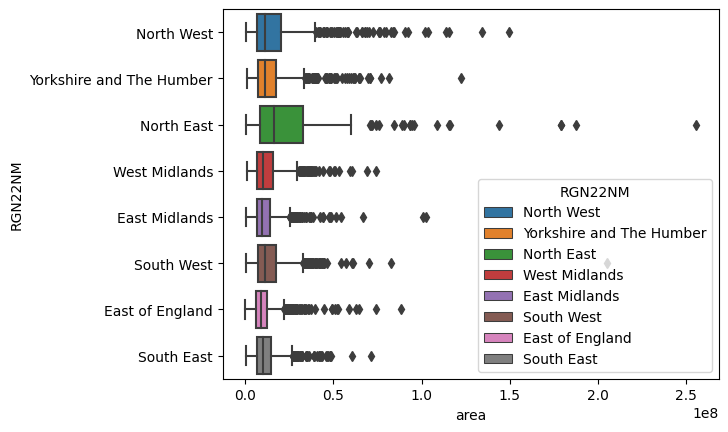

In [77]:
sns.boxplot(
    data=parish_data[parish_data.rural_label == 'Rural'],
    x='area',
    y='RGN22NM',
    hue='RGN22NM',
    dodge=False
)

In [69]:
parish_data.sort_values(by='area', ascending=False).head(10)

,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
7383,E04010698,Stanhope,North East,4440,2.555671e+08,Rural
9569,E43000276,"Leeds, unparished area",Yorkshire and The Humber,639331,2.514287e+08,Mixed
9547,E43000250,"Birmingham, unparished area",West Midlands,1040773,2.085932e+08,Urban
2142,E04003316,Dartmoor Forest,South West,1737,2.048206e+08,Rural
9499,E43000188,"Kirklees, unparished area",Yorkshire and The Humber,334758,2.029514e+08,Mixed
7515,E04010867,Tarset,North East,268,1.876372e+08,Rural
9490,E43000173,"Sheffield, unparished area",Yorkshire and The Humber,494678,1.846339e+08,Mixed
7504,E04010854,Rochester,North East,317,1.792089e+08,Rural
7417,E04010746,Biddlestone,North East,166,1.790855e+08,Rural
9484,E43000164,"Wigan, unparished area",North West,318474,1.701032e+08,Mixed


In [70]:
parish_data.sort_values(by='area', ascending=True).head(10)

,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
3151,E04004731,Gilston,East of England,420,62300.779198,Rural
9228,E04013017,Harlestone Manor,East Midlands,589,162744.046280,Rural
2662,E04004105,Manningtree,East of England,874,200862.181381,Rural
7221,E04010467,Orchard Park,East of England,2499,344758.359665,Urban
3330,E04004952,Downswood,South East,2197,369519.545578,Urban
7666,E04011042,Bache,North West,252,385883.755684,Urban
8616,E04012334,Britwell,South East,2724,390626.264954,Urban
8883,E04012646,Sherfield Park,South East,2387,470580.768394,Urban
7580,E04010939,Edleston,North West,868,490441.392754,Rural
1252,E04001675,Alwalton,East of England,276,493533.963669,Urban


In [72]:
mergey.sort_values(by='SHAPE_Area').head(5)

,OBJECTID,PARNCP21CD,PARNCP21NM,PARNCP21NW,BNG_E,BNG_N,LONG,LAT,SHAPE_Leng,SHAPE_Area,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
2661,2970,E04004105,Manningtree,NaN,610617,231897,1.063132,51.945690,1876.865032,118584.608949,"MULTIPOLYGON (((118018.975 6790768.948, 118204...",E04004105,Manningtree,East of England,874,2.008622e+05,Rural
9019,10139,E04012800,Orgreave,NaN,442896,385936,-1.356790,53.368568,2033.993192,172682.940775,"POLYGON ((-150588.740 7051059.722, -151677.140...",E04012800,Orgreave,Yorkshire and The Humber,772,1.041103e+06,Urban
9100,10224,E04012885,Hamilton Lea,NaN,464056,306993,-1.054440,52.656898,1869.790539,174521.695721,"POLYGON ((-116748.780 6919436.119, -117882.176...",E04012885,Hamilton Lea,East Midlands,1171,9.682270e+06,Rural
7665,8702,E04011042,Bache,NaN,340008,368217,-2.899680,53.207630,2419.746948,284560.104045,"POLYGON ((-322201.346 7021504.960, -323010.887...",E04011042,Bache,North West,252,3.858838e+05,Urban
7220,8203,E04010467,Orchard Park,NaN,544794,261674,0.118896,52.234230,2908.075930,311428.008360,"POLYGON ((14453.893 6842844.170, 13327.130 684...",E04010467,Orchard Park,East of England,2499,3.447584e+05,Urban


In [73]:
parish_data[parish_data.PAR22NM == 'Manningtree']

,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
2662,E04004105,Manningtree,East of England,874,200862.181381,Rural


In [74]:
mergey.sort_values(by='SHAPE_Area', ascending=False).head(5)

,OBJECTID,PARNCP21CD,PARNCP21NM,PARNCP21NW,BNG_E,BNG_N,LONG,LAT,SHAPE_Leng,SHAPE_Area,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
7382,8386,E04010698,Stanhope,NaN,391044,538217,-2.14062,54.738838,76113.107155,2.561622e+08,"POLYGON ((-241503.469 7323842.355, -239699.094...",E04010698,Stanhope,North East,4440,2.555671e+08,Rural
9547,10682,E43000276,"Leeds, unparished area",NaN,428535,433569,-1.56827,53.797661,135617.101943,2.487788e+08,"MULTIPOLYGON (((-153809.322 7133131.375, -1532...",E43000276,"Leeds, unparished area",Yorkshire and The Humber,639331,2.514287e+08,Mixed
9525,10659,E43000250,"Birmingham, unparished area",NaN,407685,287216,-1.88826,52.482819,77619.613557,2.085351e+08,"POLYGON ((-198946.849 6892778.477, -199729.279...",E43000250,"Birmingham, unparished area",West Midlands,1040773,2.085932e+08,Urban
2141,2377,E04003316,Dartmoor Forest,NaN,261135,79987,-3.96369,50.603020,73318.941211,2.051095e+08,"POLYGON ((-441541.829 6569541.853, -440713.918...",E04003316,Dartmoor Forest,South West,1737,2.048206e+08,Rural
9477,10611,E43000188,"Kirklees, unparished area",NaN,409247,414245,-1.86166,53.624668,114698.530997,2.041268e+08,"MULTIPOLYGON (((-192738.965 7109848.793, -1935...",E43000188,"Kirklees, unparished area",Yorkshire and The Humber,334758,2.029514e+08,Mixed


In [20]:
mergey = geo_df.merge(parish_data, how='inner', right_on='PAR22CD', left_on='PARNCP21CD')
mergey.head()

,OBJECTID,PARNCP21CD,PARNCP21NM,PARNCP21NW,BNG_E,BNG_N,LONG,LAT,SHAPE_Leng,SHAPE_Area,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
0,1,E04000001,Blackrod,NaN,361020,410662,-2.59036,53.591091,14444.180308,8.373290e+06,"POLYGON ((-286096.135 7093910.215, -284094.155...",E04000001,Blackrod,North West,5517,8.599134e+06,Urban
1,2,E04000002,Horwich,NaN,365741,411963,-2.51919,53.603111,20207.437672,1.454181e+07,"POLYGON ((-279457.871 7099705.842, -280193.379...",E04000002,Horwich,North West,20908,1.424275e+07,Mixed
2,3,E04000003,Westhoughton,NaN,365008,406179,-2.52961,53.551079,19733.095935,1.803568e+07,"POLYGON ((-278326.427 7083159.503, -279065.547...",E04000003,Westhoughton,North West,25340,1.786415e+07,Mixed
3,5,E04000005,Saddleworth,NaN,400672,407034,-1.99132,53.559940,41614.516542,7.587037e+07,"POLYGON ((-223693.396 7097907.619, -220596.023...",E04000005,Saddleworth,North West,25466,7.613353e+07,Mixed
4,6,E04000008,Mossley,NaN,398518,402180,-2.02381,53.516312,15077.441495,8.405358e+06,"POLYGON ((-221056.954 7079100.960, -223662.708...",E04000008,Mossley,North West,11566,8.658747e+06,Mixed


/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/4120443990.py:5: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mergey.geometry))


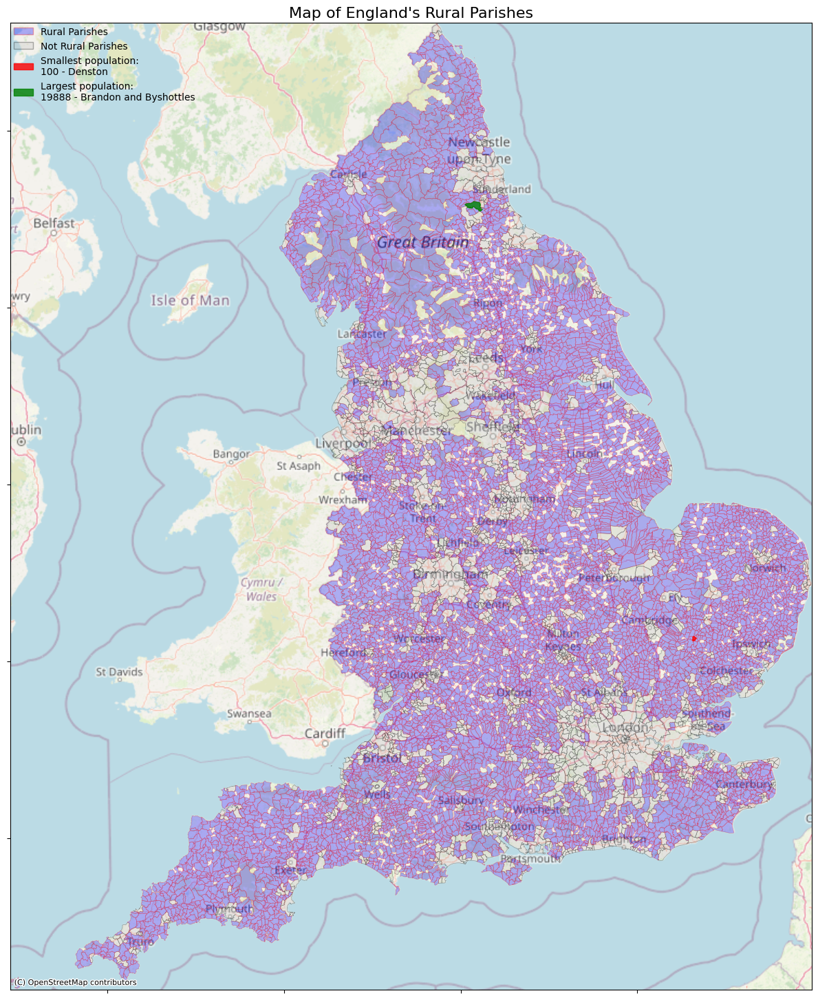

In [66]:
from shapely.ops import cascaded_union

fig, ax = plt.subplots(figsize=(12,18))
# Define Overall Polygon
overall_polygon = gdp.GeoSeries(cascaded_union(mergey.geometry))
# Define bounding box
bounds = overall_polygon.bounds
bounding_box = [
    bounds['minx'][0],
    bounds['maxx'][0],
    bounds['miny'][0],
    bounds['maxy'][0],
]
# Set bounds
ax.set_xlim(bounding_box[0]-1000, bounding_box[1] + 1000)
ax.set_ylim(bounding_box[2]-1000, bounding_box[3] + 1000)

# Plot borough borders
# Plot borough borders
mergey[mergey.rural_label != 'Rural'].plot(
    ax=ax, 
    alpha=0.3, 
    edgecolor='black', 
    linewidth=0.5,
    facecolor='silver',
)

mergey[mergey.rural_label == 'Rural'].plot(
    ax=ax, 
    alpha=0.3, 
    edgecolor='red', 
    linewidth=0.5,
    facecolor='blue',
)

mergey[mergey.rural_label == 'Rural'].sort_values(by='population').head(1).plot(
    ax=ax,
    alpha=0.8,
    edgecolor='red',
    linewidth=1,
    facecolor='red'
)

mergey[mergey.rural_label=='Rural'].sort_values(by='population', ascending=False).head(1).plot(
    ax=ax,
    alpha=0.8,
    edgecolor='green',
    linewidth=1,
    facecolor='green'
)

import contextily as cx # map backgrounds
# Add background
cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik, alpha=0.8)

# Remove axis 
ax.set_yticklabels([])
ax.set_xticklabels([])

import matplotlib.patches as mpatches
rural_patch = mpatches.Patch(facecolor='blue', edgecolor='red', alpha=0.3, label='Rural Parishes')
not_rural_patch = mpatches.Patch(facecolor='silver', edgecolor='black', alpha=0.3, label='Not Rural Parishes')
small_population_patch = mpatches.Patch(
    facecolor='red', 
    edgecolor='red', 
    alpha=0.8, 
    label='Smallest population:\n{0} - {1}'.format(
        mergey[mergey.rural_label == 'Rural'].sort_values(by='population').head(1).population.values[0],
        mergey[mergey.rural_label == 'Rural'].sort_values(by='population').head(1).PARNCP21NM.values[0]
    )
)

large_population_patch = mpatches.Patch(
    facecolor='green', 
    edgecolor='green', 
    alpha=0.8, 
    label='Largest population:\n{0} - {1}'.format(
        mergey[mergey.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).population.values[0],
        mergey[mergey.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).PARNCP21NM.values[0]
    )
)
leg = plt.legend(
    handles=[rural_patch, not_rural_patch, small_population_patch, large_population_patch],
#        bbox_to_anchor=(0.79, 1),
    loc=2,
    borderaxespad=0.,
    frameon=False,
    prop={'size': 10}
)
plt.title("Map of England's Rural Parishes".format(rgnnm[0]), fontsize=16)
plt.tight_layout()
plt.savefig('results/map_of_rural_parishes.png')

plt.show()

In [28]:
mergey[mergey.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(5)

,OBJECTID,PARNCP21CD,PARNCP21NM,PARNCP21NW,BNG_E,BNG_N,LONG,LAT,SHAPE_Leng,SHAPE_Area,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
7301,8293,E04010603,Brandon and Byshottles,NaN,421578,540321,-1.66624,54.757381,35773.281719,3.321965e+07,"POLYGON ((-183402.441 7319887.787, -182089.273...",E04010603,Brandon and Byshottles,North East,19888,3.320214e+07,Rural
154,158,E04000181,Denby Dale,NaN,423285,410728,-1.64968,53.592628,31106.947799,4.105787e+07,"POLYGON ((-179732.974 7099624.097, -178947.266...",E04000181,Denby Dale,Yorkshire and The Humber,16628,4.115312e+07,Rural
9110,10236,E04012897,Seaton Valley,NaN,431633,575828,-1.50611,55.075909,27516.370060,2.874229e+07,"POLYGON ((-166318.660 7381682.827, -164543.940...",E04012897,Seaton Valley,North East,15532,2.839968e+07,Rural
181,188,E04000232,Hemsworth,NaN,442406,413941,-1.36038,53.620312,18648.687301,1.706889e+07,"POLYGON ((-151408.293 7102555.806, -150343.577...",E04000232,Hemsworth,Yorkshire and The Humber,14170,1.683837e+07,Rural
2351,2645,E04003630,Portland,NaN,369301,72953,-2.43471,50.555511,28116.848576,1.219375e+07,"POLYGON ((-278744.514 6550238.554, -278586.509...",E04003630,Portland,South West,13559,1.214060e+07,Rural


In [30]:
mergey.head()

,OBJECTID,PARNCP21CD,PARNCP21NM,PARNCP21NW,BNG_E,BNG_N,LONG,LAT,SHAPE_Leng,SHAPE_Area,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
0,1,E04000001,Blackrod,NaN,361020,410662,-2.59036,53.591091,14444.180308,8.373290e+06,"POLYGON ((-286096.135 7093910.215, -284094.155...",E04000001,Blackrod,North West,5517,8.599134e+06,Urban
1,2,E04000002,Horwich,NaN,365741,411963,-2.51919,53.603111,20207.437672,1.454181e+07,"POLYGON ((-279457.871 7099705.842, -280193.379...",E04000002,Horwich,North West,20908,1.424275e+07,Mixed
2,3,E04000003,Westhoughton,NaN,365008,406179,-2.52961,53.551079,19733.095935,1.803568e+07,"POLYGON ((-278326.427 7083159.503, -279065.547...",E04000003,Westhoughton,North West,25340,1.786415e+07,Mixed
3,5,E04000005,Saddleworth,NaN,400672,407034,-1.99132,53.559940,41614.516542,7.587037e+07,"POLYGON ((-223693.396 7097907.619, -220596.023...",E04000005,Saddleworth,North West,25466,7.613353e+07,Mixed
4,6,E04000008,Mossley,NaN,398518,402180,-2.02381,53.516312,15077.441495,8.405358e+06,"POLYGON ((-221056.954 7079100.960, -223662.708...",E04000008,Mossley,North West,11566,8.658747e+06,Mixed


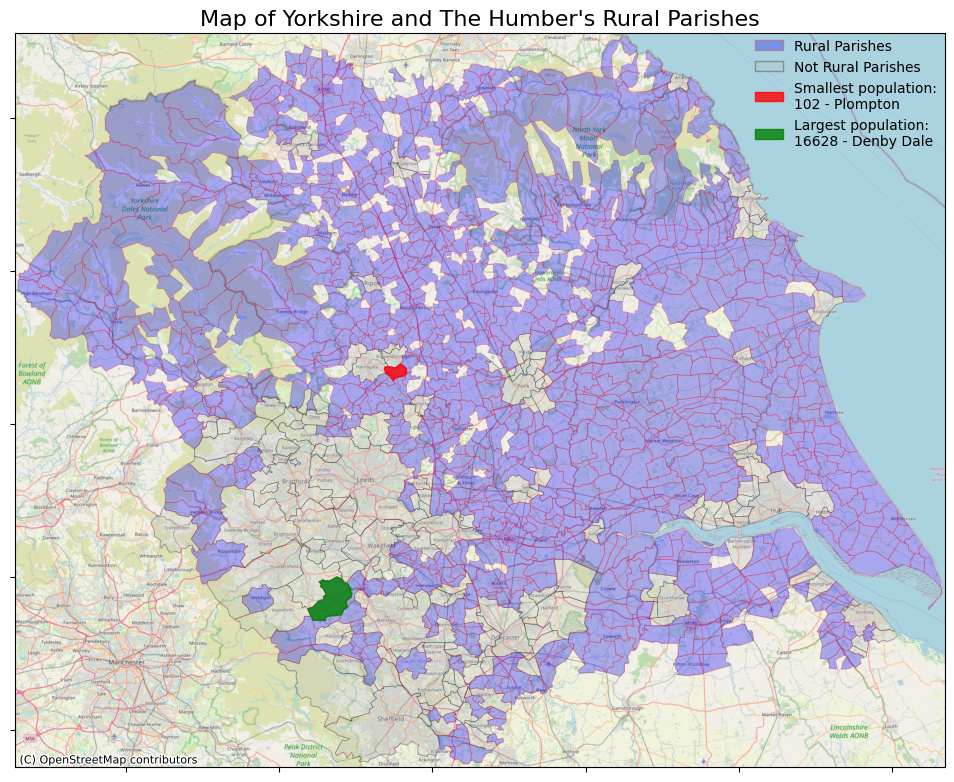

In [54]:
from shapely.ops import cascaded_union

fig, ax = plt.subplots(figsize=(12,18))
mini = mergey[mergey.RGN22NM == 'Yorkshire and The Humber']
# Define Overall Polygon
#overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))
# Define bounding box
#bounds = overall_polygon.bounds
bounding_box = [
    bounds['minx'][0],
    bounds['maxx'][0],
    bounds['miny'][0],
    bounds['maxy'][0],
]
# Set bounds
ax.set_xlim(bounding_box[0]-1000, bounding_box[1] + 1000)
ax.set_ylim(bounding_box[2]-1000, bounding_box[3] + 1000)


# Plot borough borders
mini[mini.rural_label != 'Rural'].plot(
    ax=ax, 
    alpha=0.3, 
    edgecolor='black', 
    linewidth=0.5,
    facecolor='silver',
)

mini[mini.rural_label == 'Rural'].plot(
    ax=ax, 
    alpha=0.3, 
    edgecolor='red', 
    linewidth=0.5,
    facecolor='blue',
)

mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).plot(
    ax=ax,
    alpha=0.8,
    edgecolor='red',
    linewidth=1,
    facecolor='red'
)

mini[mini.rural_label=='Rural'].sort_values(by='population', ascending=False).head(1).plot(
    ax=ax,
    alpha=0.8,
    edgecolor='green',
    linewidth=1,
    facecolor='green'
)



import contextily as cx # map backgrounds
# Add background
cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik)

# Remove axis 
ax.set_yticklabels([])
ax.set_xticklabels([])

import matplotlib.patches as mpatches
rural_patch = mpatches.Patch(facecolor='blue', edgecolor='red', alpha=0.3, label='Rural Parishes')
not_rural_patch = mpatches.Patch(facecolor='silver', edgecolor='black', alpha=0.3, label='Not Rural Parishes')
small_population_patch = mpatches.Patch(
    facecolor='red', 
    edgecolor='red', 
    alpha=0.8, 
    label='Smallest population:\n{0} - {1}'.format(
        mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).population.values[0],
        mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).PARNCP21NM.values[0]
    )
)

large_population_patch = mpatches.Patch(
    facecolor='green', 
    edgecolor='green', 
    alpha=0.8, 
    label='Largest population:\n{0} - {1}'.format(
        mini[mini.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).population.values[0],
        mini[mini.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).PARNCP21NM.values[0]
    )
)
leg = plt.legend(
    handles=[rural_patch, not_rural_patch, small_population_patch, large_population_patch],
    bbox_to_anchor=(0.79, 1),
    loc=2,
    borderaxespad=0.,
    frameon=False,
    prop={'size': 10}
)
plt.title("Map of Yorkshire and The Humber's Rural Parishes", fontsize=16)

plt.savefig('results/map_of_rural_parishes_yorkshire.png')

plt.show()

In [38]:
mini.sort_values(by='population').head(1)[['population', 'PARNCP21NM']].values[0]

SyntaxError: invalid syntax (4030953025.py, line 1)

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/172922080.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


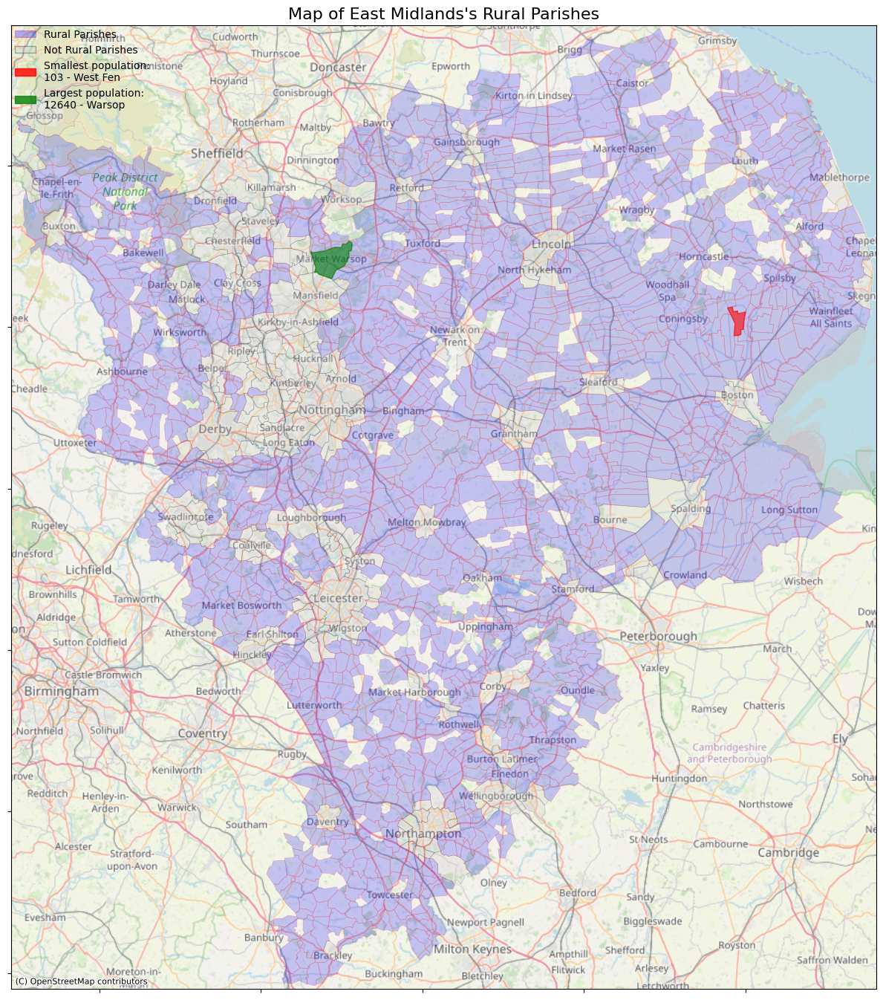

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/172922080.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


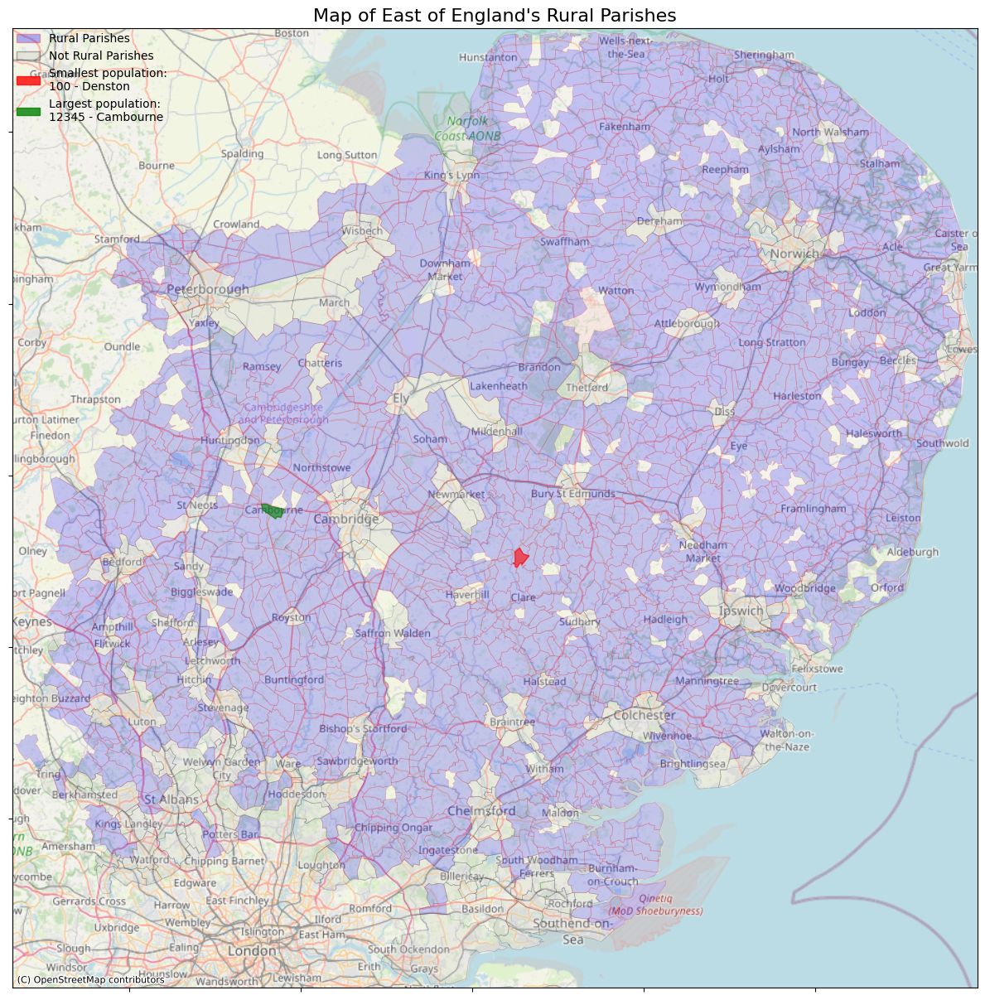

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/172922080.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


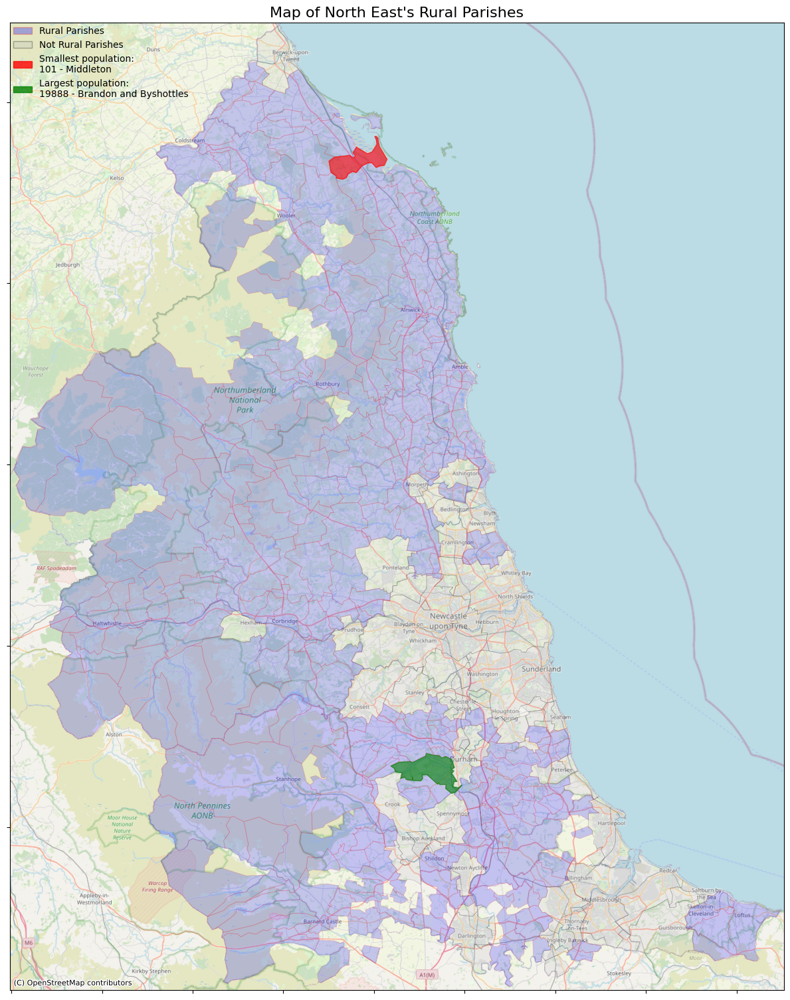

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/172922080.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


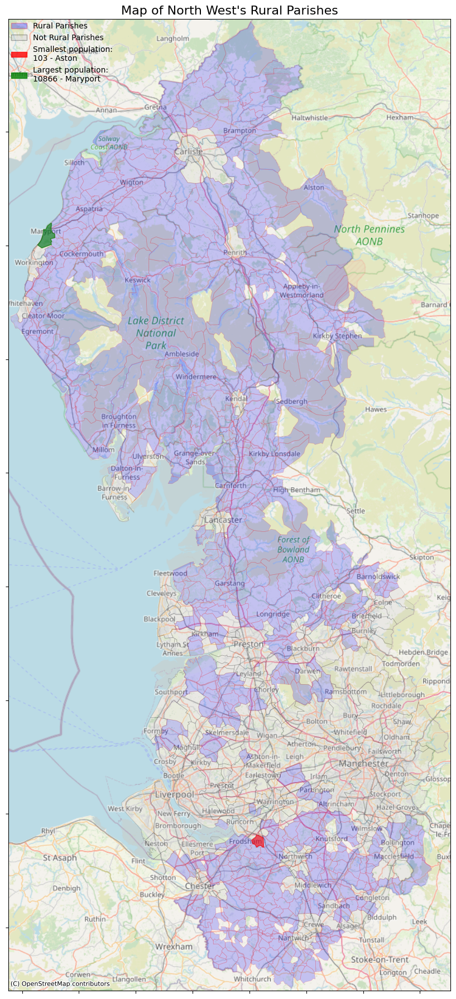

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/172922080.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


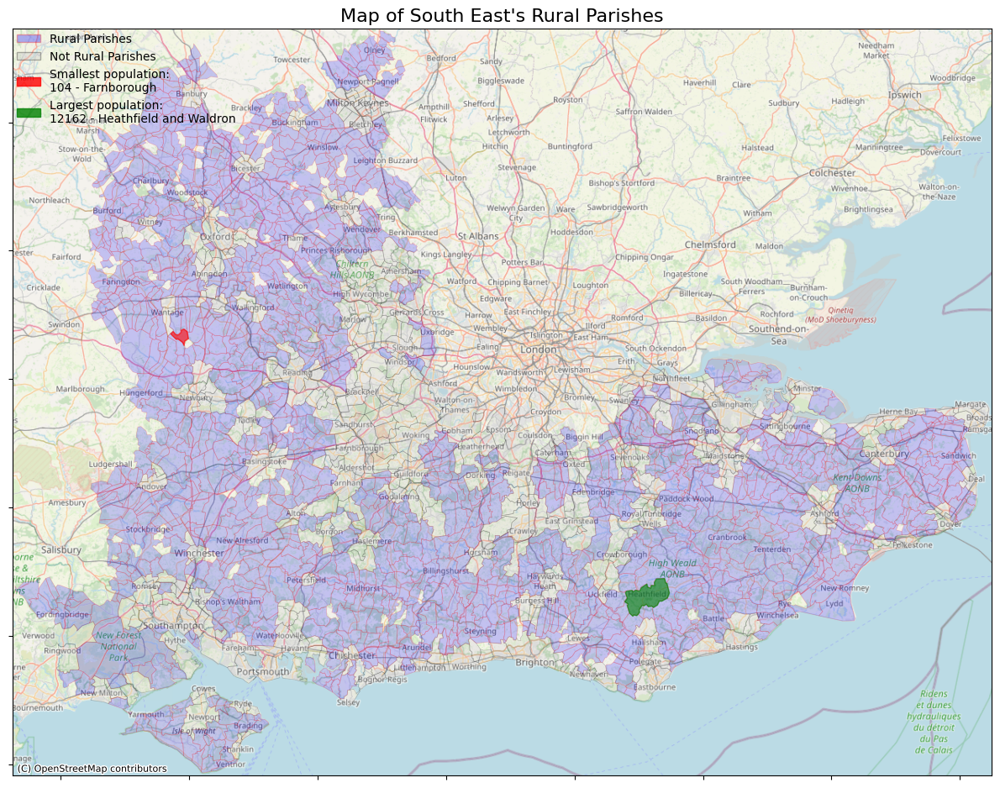

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/172922080.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


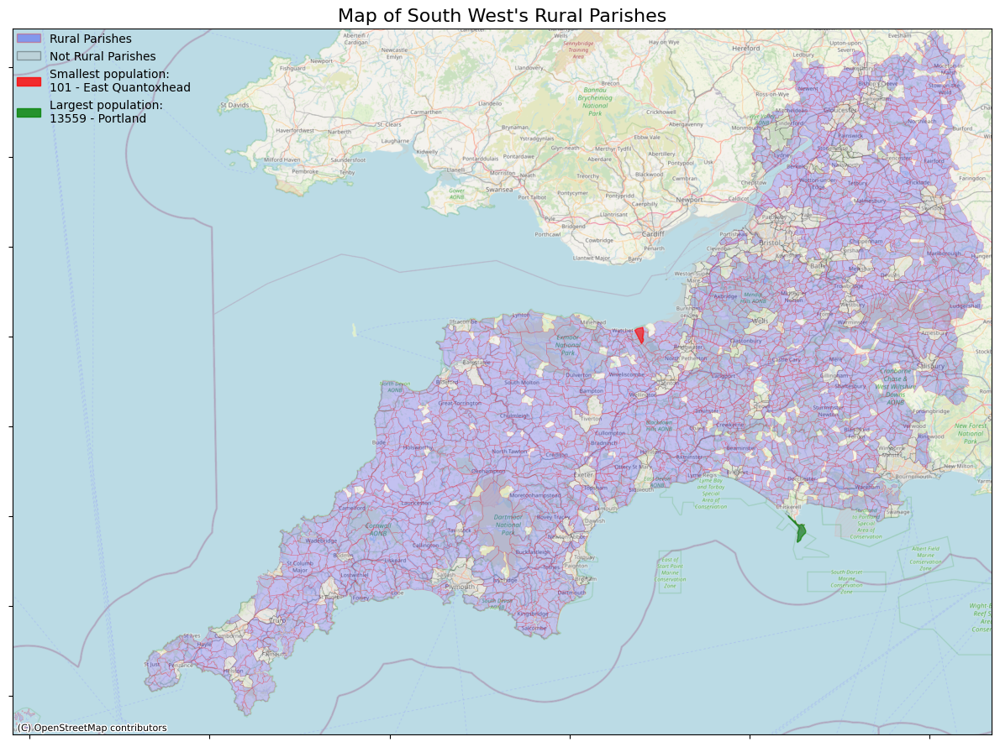

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/172922080.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


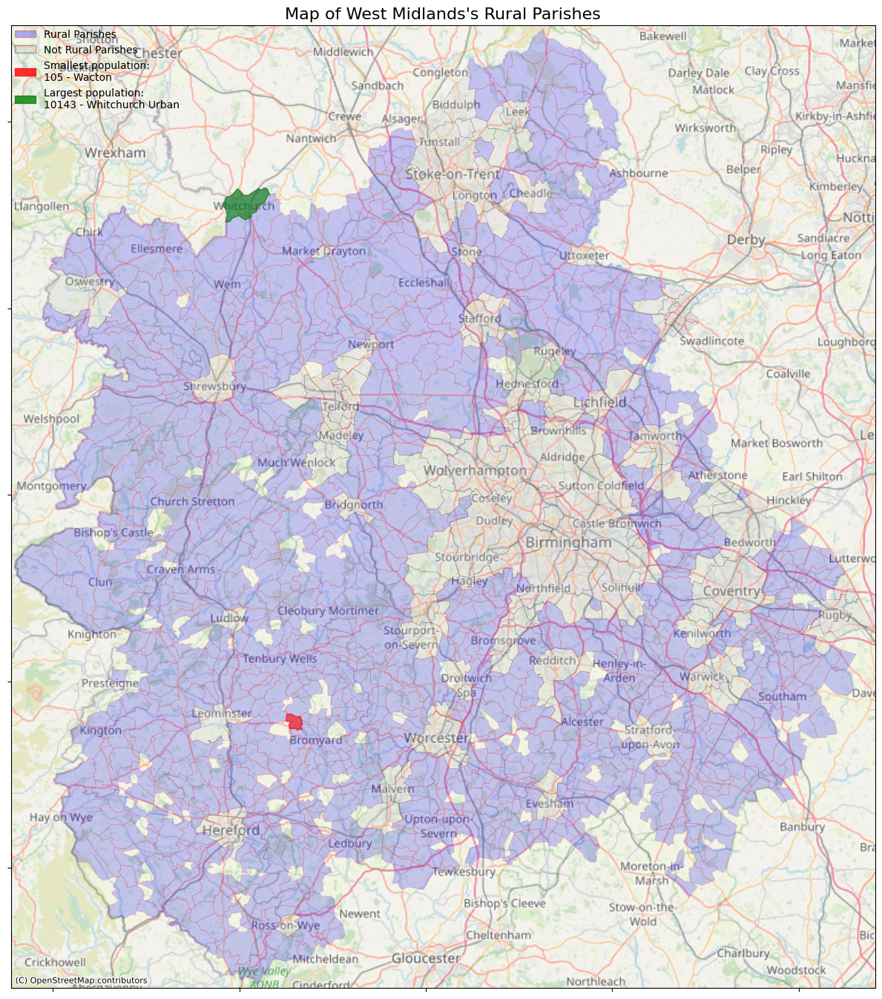

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_61910/172922080.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


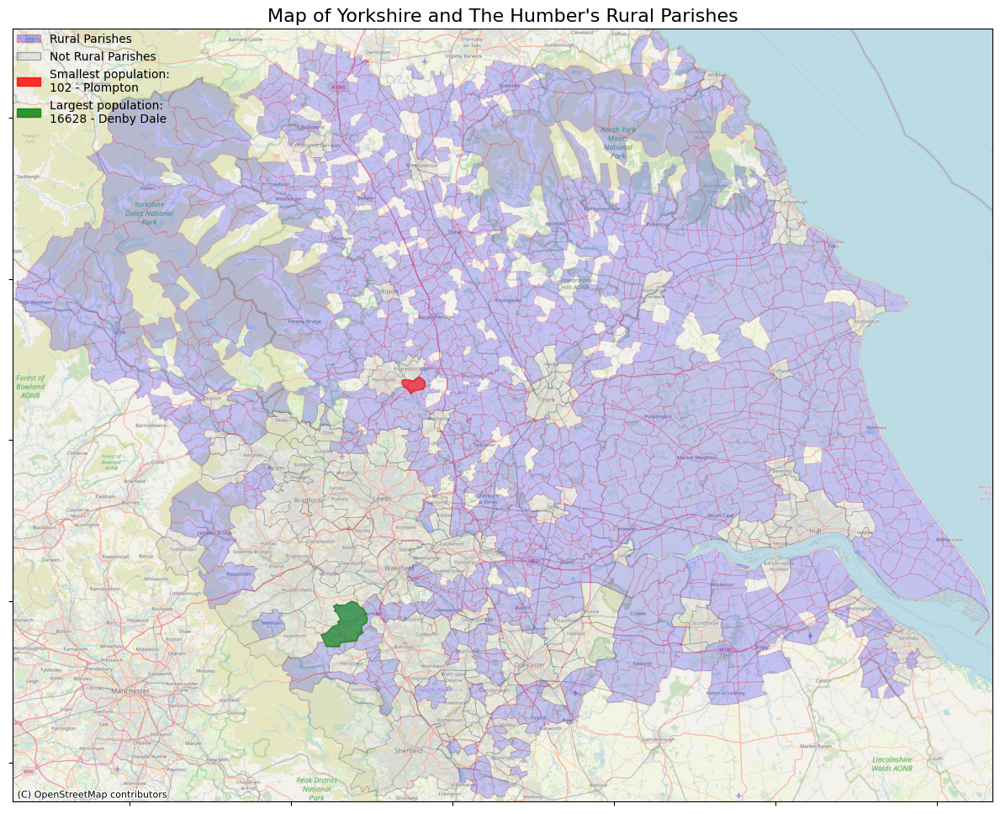

In [64]:
from shapely.ops import cascaded_union

for rgnnm, mini in mergey.groupby(['RGN22NM']):
    if mini[mini.rural_label == 'Rural'].shape[0] < 5:
        continue
    fig, ax = plt.subplots(figsize=(12,18))
    # Define Overall Polygon
    overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))
    # Define bounding box
    bounds = overall_polygon.bounds
    bounding_box = [
        bounds['minx'][0],
        bounds['maxx'][0],
        bounds['miny'][0],
        bounds['maxy'][0],
    ]
    # Set bounds
    ax.set_xlim(bounding_box[0]-1000, bounding_box[1] + 1000)
    ax.set_ylim(bounding_box[2]-1000, bounding_box[3] + 1000)

    
    # Plot borough borders
    mini[mini.rural_label != 'Rural'].plot(
        ax=ax, 
        alpha=0.2, 
        edgecolor='black', 
        linewidth=0.5,
        facecolor='silver',
    )

    mini[mini.rural_label == 'Rural'].plot(
        ax=ax, 
        alpha=0.2, 
        edgecolor='red', 
        linewidth=0.5,
        facecolor='blue',
    )

    mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).plot(
        ax=ax,
        alpha=0.6,
        edgecolor='red',
        linewidth=1,
        facecolor='red'
    )

    mini[mini.rural_label=='Rural'].sort_values(by='population', ascending=False).head(1).plot(
        ax=ax,
        alpha=0.6,
        edgecolor='green',
        linewidth=1,
        facecolor='green'
    )

    import contextily as cx # map backgrounds
    # Add background
    cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik, alpha=0.8)

    # Remove axis 
    ax.set_yticklabels([])
    ax.set_xticklabels([])

    import matplotlib.patches as mpatches
    rural_patch = mpatches.Patch(facecolor='blue', edgecolor='red', alpha=0.3, label='Rural Parishes')
    not_rural_patch = mpatches.Patch(facecolor='silver', edgecolor='black', alpha=0.3, label='Not Rural Parishes')
    small_population_patch = mpatches.Patch(
        facecolor='red', 
        edgecolor='red', 
        alpha=0.8, 
        label='Smallest population:\n{0} - {1}'.format(
            mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).population.values[0],
            mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).PARNCP21NM.values[0]
        )
    )

    large_population_patch = mpatches.Patch(
        facecolor='green', 
        edgecolor='green', 
        alpha=0.8, 
        label='Largest population:\n{0} - {1}'.format(
            mini[mini.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).population.values[0],
            mini[mini.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).PARNCP21NM.values[0]
        )
    )
    leg = plt.legend(
        handles=[rural_patch, not_rural_patch, small_population_patch, large_population_patch],
#        bbox_to_anchor=(0.79, 1),
        loc=2,
        borderaxespad=0.,
        frameon=False,
        prop={'size': 10}
    )
    plt.title("Map of {0}\'s Rural Parishes".format(rgnnm[0]), fontsize=16)
    plt.tight_layout()
    plt.savefig('results/map_of_rural_parishes_{0}.png'.format(rgnnm[0]))

    plt.show()